# Image preprocessing



### Read Image and show the output

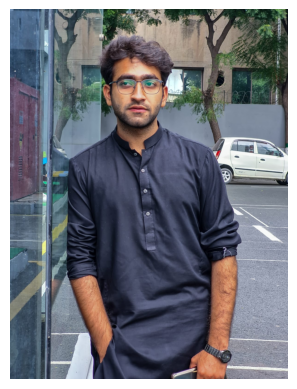

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt

# Read the image
image = Image.open('/content/image.proc.jpg')

# Display the image
plt.imshow(image)
plt.axis('off')
plt.show()

### Change the image into greyscale


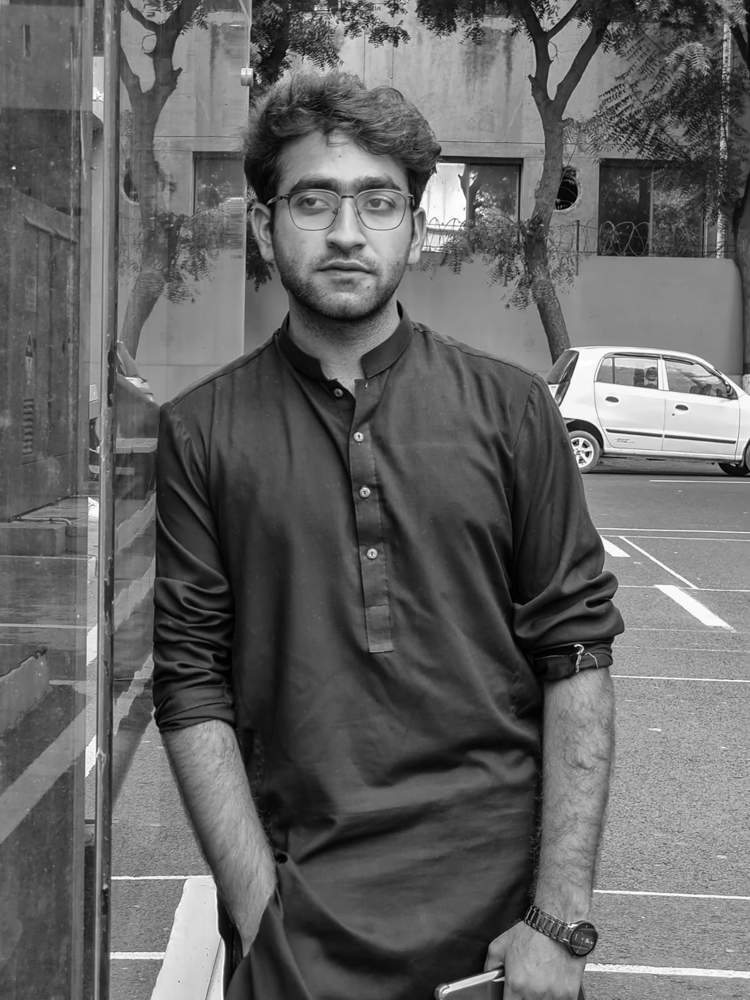

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

# Read the image
image = cv2.imread('/content/image.proc.jpg')

# Convert the image to grayscale
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Display the grayscale image
cv2_imshow(gray_image)



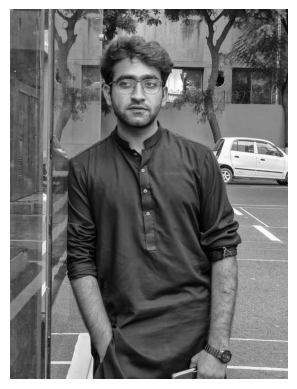

In [ ]:


# Read the image
image = Image.open('/content/image.proc.jpg')

# Convert the image to grayscale manually
gray_data = [
    int(0.2989 * r + 0.5870 * g + 0.1140 * b)
    for r, g, b in image.getdata()
]
gray_image = Image.new('L', image.size)
gray_image.putdata(gray_data)

# Display the image
plt.imshow(np.asarray(gray_image), cmap='gray')
plt.axis('off')
plt.show()



###  Add noise to an image.

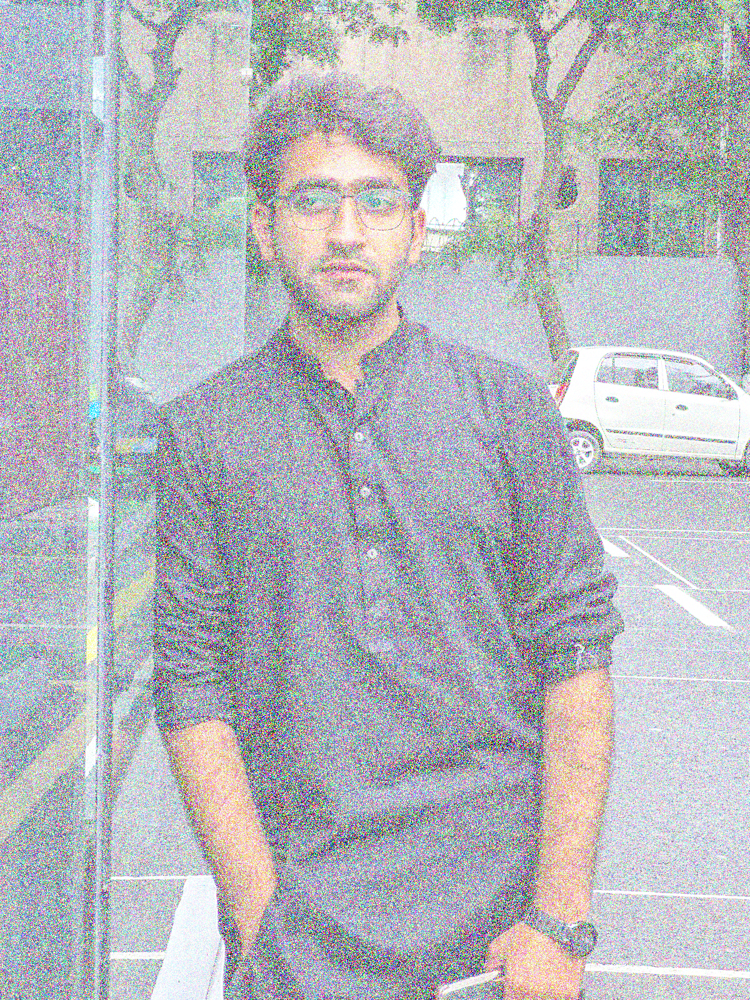

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

image = cv2.imread('/content/image.proc.jpg')

if image is not None:

    mean = 0
    stddev = 25

    # Generate Gaussian noise
    noise = np.random.normal(mean, stddev, image.shape).astype(np.uint8)

    # Add the noise to the image
    noisy_image = cv2.add(image, noise)

    # Display the noisy image
    cv2_imshow(noisy_image)

### Image Enhancement
1. Color correction (Correct color cast)
2. Noise Reduction (Remove noise)
3. Enhance using (brigthness and contrast)

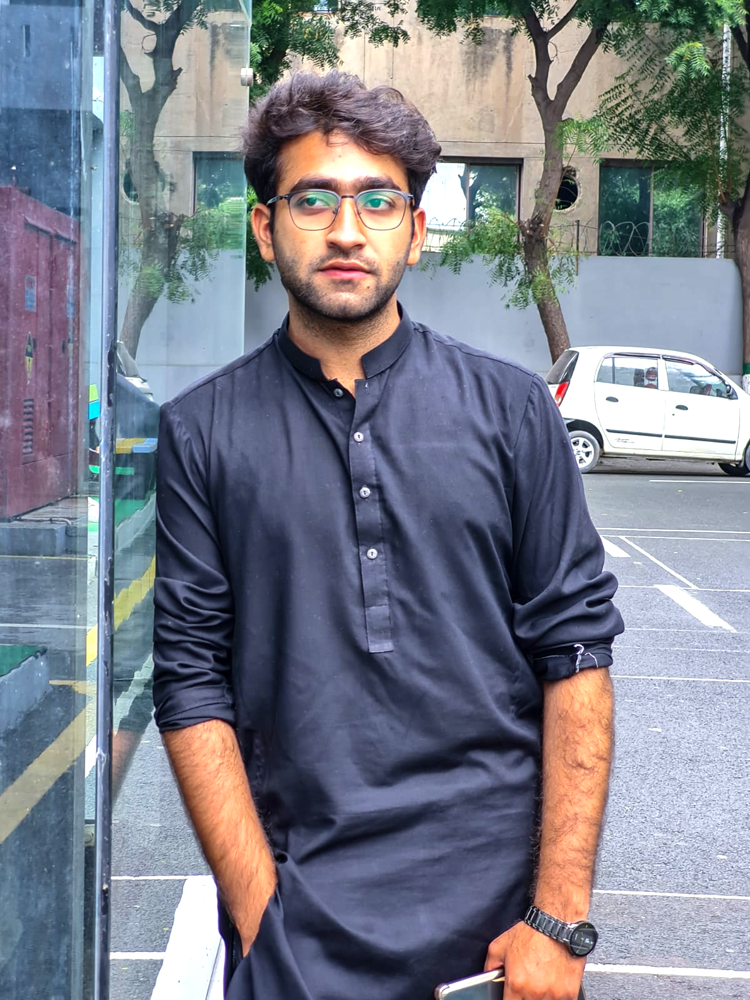

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Load the image
image = cv2.imread('/content/image.proc.jpg')

if image is not None:
    # Color Correction (Gray World Correction)
    image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    avg_gray = np.mean(image_gray)
    scale_factor = 128 / avg_gray  # 128 is the desired average intensity (for gray world correction)
    corrected_image = cv2.convertScaleAbs(image, alpha=scale_factor, beta=0)

     # Display the color-corrected image
    cv2_imshow(corrected_image)

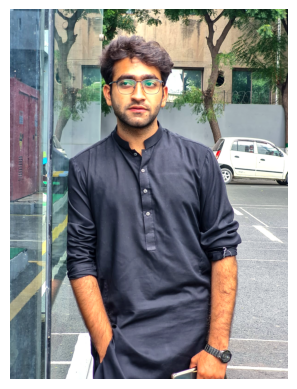

In [ ]:
import numpy as np
from skimage import io, exposure, color
import matplotlib.pyplot as plt

# Load the image
image = io.imread('/content/image.proc.jpg')

if image is not None:
    # Convert the image to float for accurate calculations
    image_float = image.astype(float)

    # Calculate the average color value for each channel
    avg_r = np.mean(image_float[:, :, 0])
    avg_g = np.mean(image_float[:, :, 1])
    avg_b = np.mean(image_float[:, :, 2])

    # Calculate the scaling factors for each channel
    scale_r = 128 / avg_r
    scale_g = 128 / avg_g
    scale_b = 128 / avg_b

    # Apply color correction to each channel
    corrected_image = image_float.copy()
    corrected_image[:, :, 0] *= scale_r
    corrected_image[:, :, 1] *= scale_g
    corrected_image[:, :, 2] *= scale_b

    # Ensure that values are within the valid range [0, 255]
    corrected_image = np.clip(corrected_image, 0, 255)

    # Convert the corrected image back to uint8 data type
    corrected_image = corrected_image.astype(np.uint8)

    # Display the color-corrected image
    plt.imshow(corrected_image)
    plt.axis('off')
    plt.show()


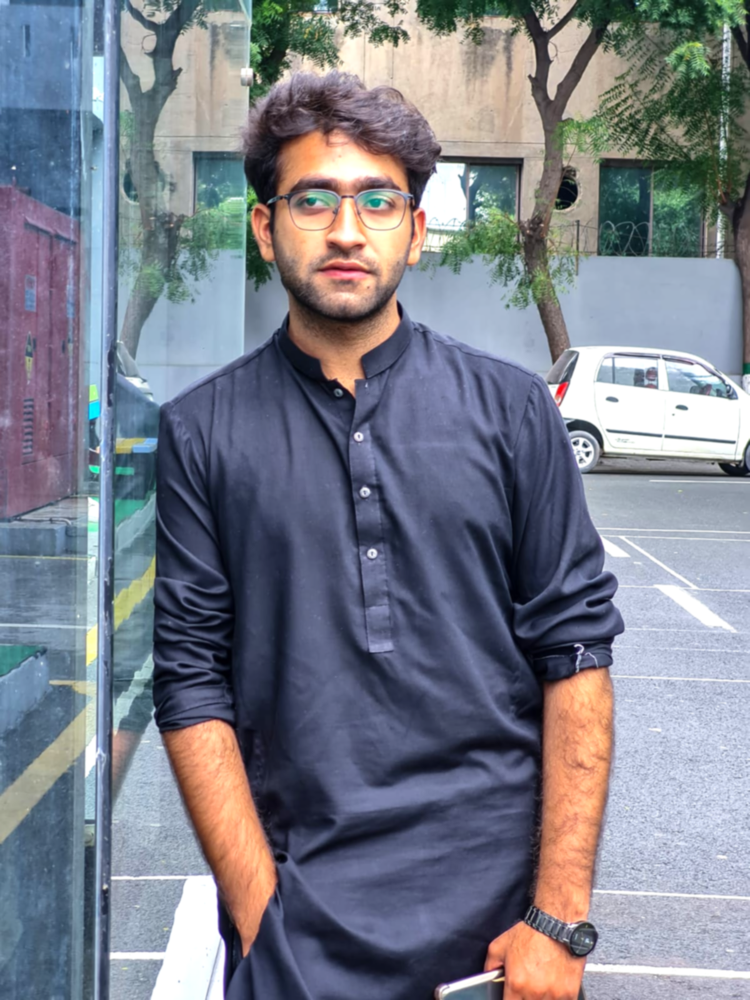

In [ ]:
blurred_image = cv2.GaussianBlur(corrected_image, (5, 5), 0)
    # Display the noise-reduced image
cv2_imshow(blurred_image)

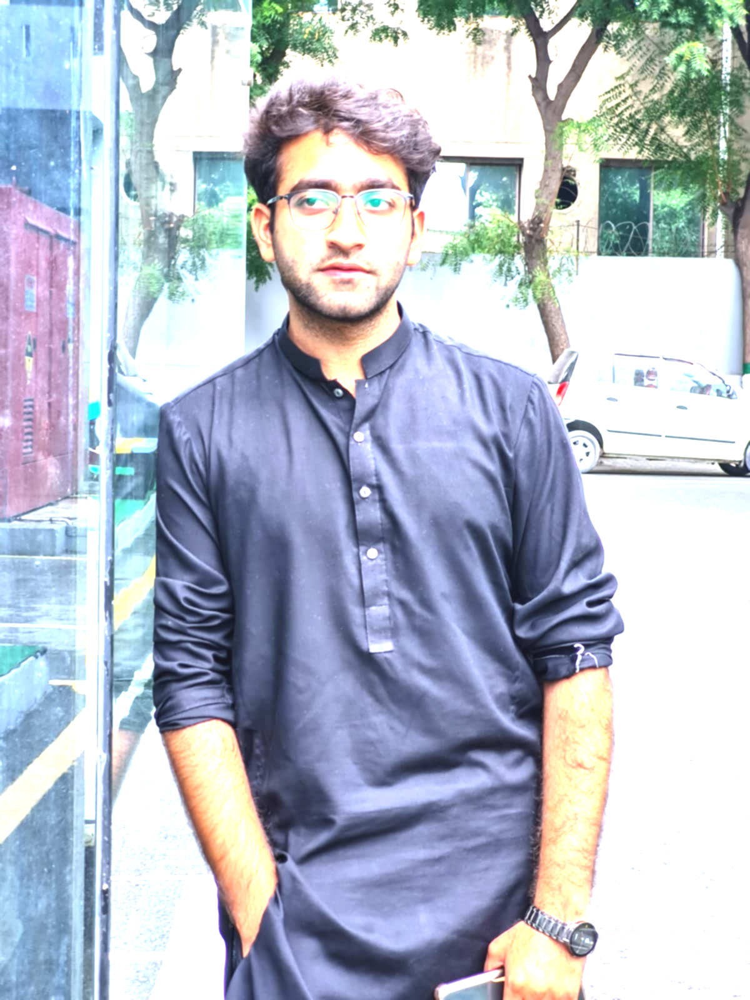

In [ ]:
alpha = 1.5
beta = 20
enhanced_image = cv2.convertScaleAbs(blurred_image, alpha=alpha, beta=beta)

    # Display the enhanced image
cv2_imshow(enhanced_image)

Image compression, compress the image and show original and compressed image as output.

Original Image:


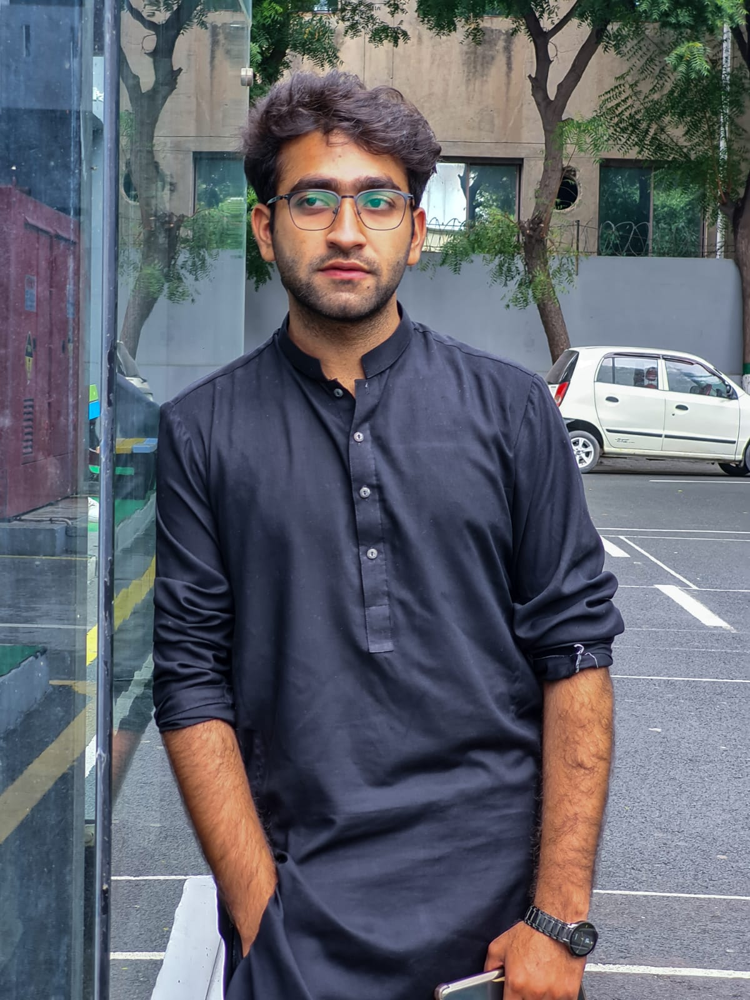

Compressed and Decompressed Image:


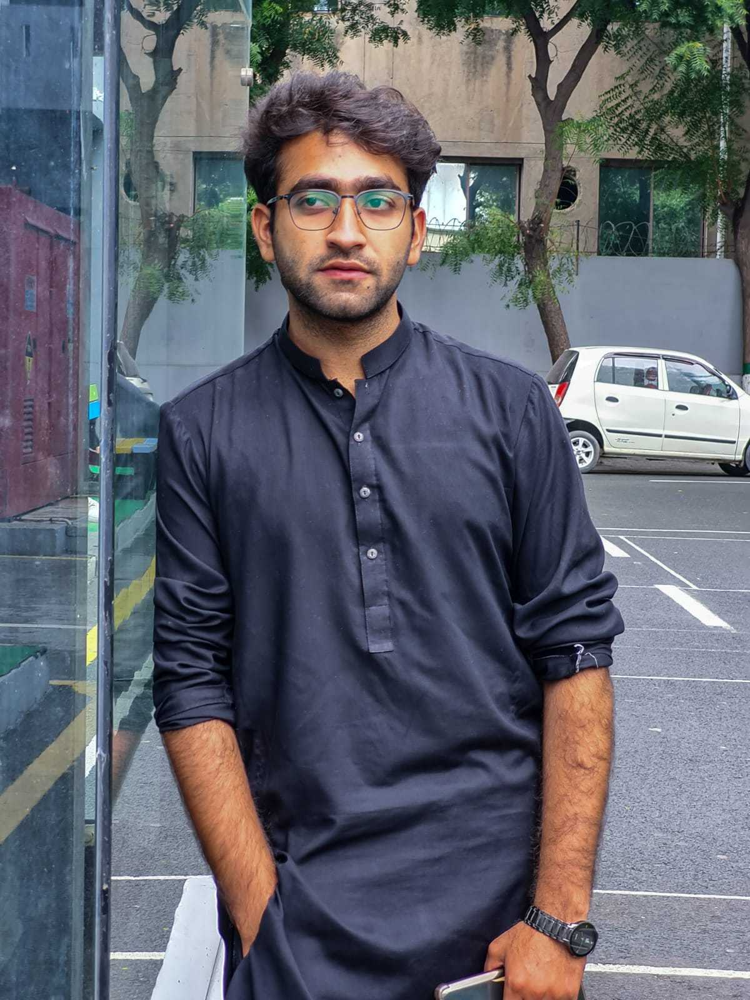

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Load the original image
original_image = cv2.imread('/content/image.proc.jpg')

if original_image is not None:
    compression_quality = 50

    _, compressed_image = cv2.imencode('.jpg', original_image, [int(cv2.IMWRITE_JPEG_QUALITY), compression_quality])

    # Decode the compressed image
    decompressed_image = cv2.imdecode(compressed_image, cv2.IMREAD_COLOR)

    # Display the original image
    print("Original Image:")
    cv2_imshow(original_image)


    # Display the compressed and decompressed image
    print("Compressed and Decompressed Image:")
    cv2_imshow(decompressed_image)

Perform feature extraction by edge detection

Detected Edges:


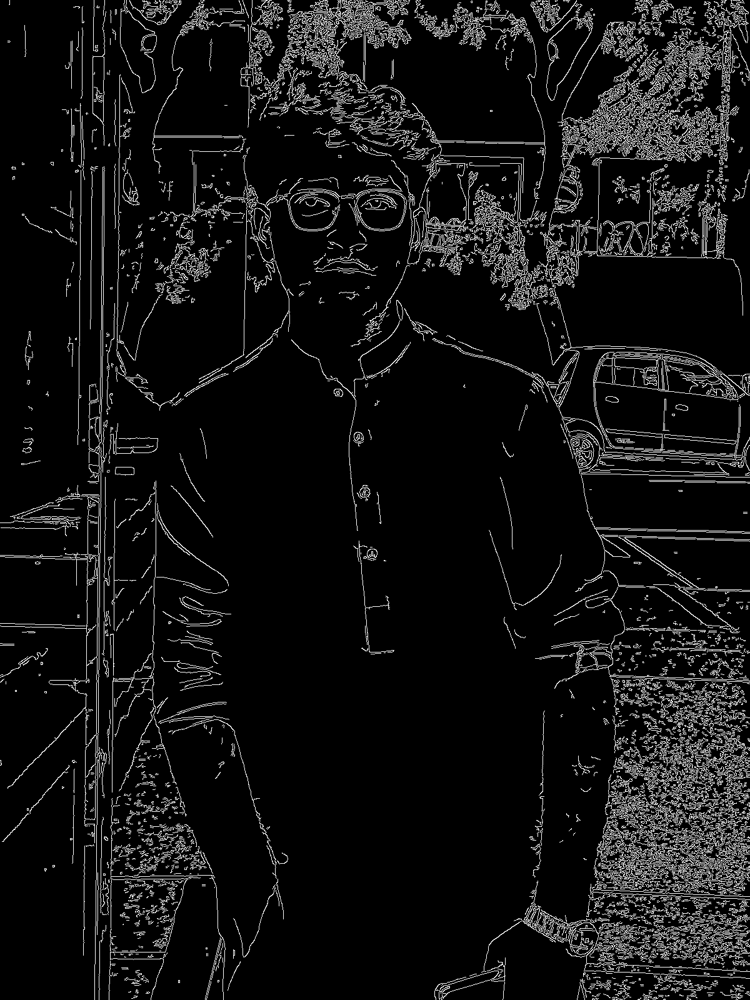

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Load the image
image = cv2.imread('/content/image.proc.jpg', cv2.IMREAD_GRAYSCALE)

if image is not None:
    # Apply Canny edge detection
    edges = cv2.Canny(image, 100, 200)  # You can adjust the threshold values as needed

    # Display the detected edges
    print("Detected Edges:")
    cv2_imshow(edges)


Perform image segmentation using opencv threshold

Segmented Image:


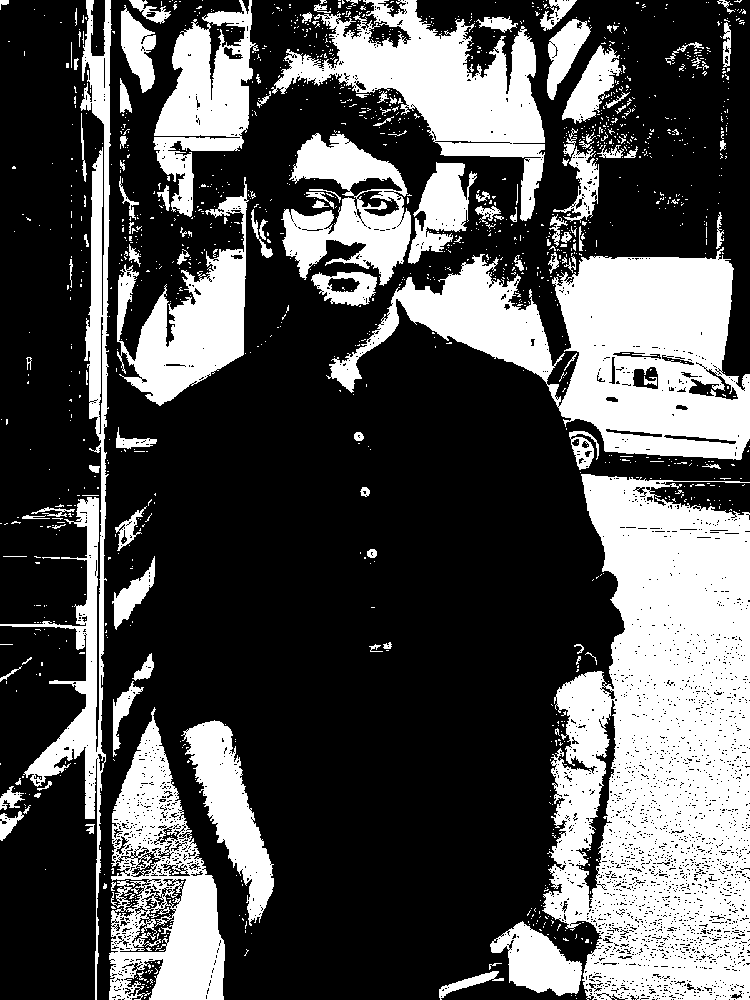

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

# Load the image
image = cv2.imread('/content/image.proc.jpg', cv2.IMREAD_GRAYSCALE)

if image is not None:
    # Apply thresholding
    _, binary_image = cv2.threshold(image, 128, 255, cv2.THRESH_BINARY)

    # Display the segmented image
    print("Segmented Image:")
    cv2_imshow(binary_image)



Perform the Morphing techniques to smooth transition & interpolation between 2 images.

- PS: for this its better to use images of same dimension, otherwise resize to prevent from error.

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

image1 = cv2.imread('/content/image.proc.jpg')
image2 = cv2.imread('/content/img222.jpg')

if image1 is not None and image2 is not None:
    if image1.shape == image2.shape:
        alpha = 0.5

        interpolated_image = cv2.addWeighted(image1, 1 - alpha, image2, alpha, 0)



        print("Interpolated Image:")
        cv2_imshow(interpolated_image)
    else:
        print("Both images must have the same dimensions for interpolation.")


Both images must have the same dimensions for interpolation.


Show the histogram of an image.
1. Greyscale Image
2. RGB Image

Output should contain Image and Histogram (e.g, RBG Image with RGB Histogram and same for Greyscale)

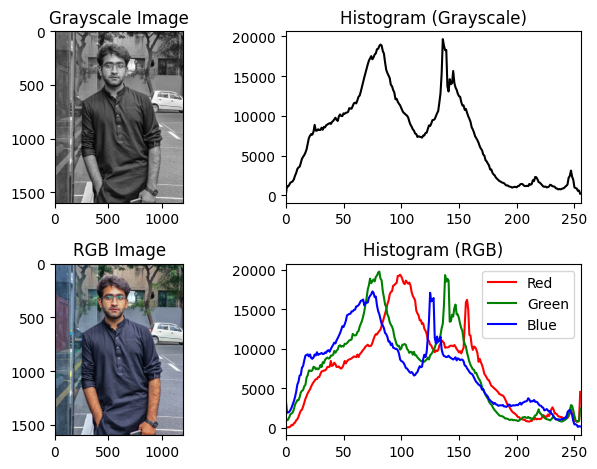

In [ ]:
import cv2
import matplotlib.pyplot as plt

rgb_image = cv2.imread('/content/image.proc.jpg')
# Convert the image to grayscale
gray_image = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2GRAY)

if gray_image is not None and rgb_image is not None:
    # Calculate the histogram for the grayscale image
    hist_gray = cv2.calcHist([gray_image], [0], None, [256], [0, 256])

    # Calculate the histograms for the RGB image channels
    hist_r = cv2.calcHist([rgb_image], [0], None, [256], [0, 256])
    hist_g = cv2.calcHist([rgb_image], [1], None, [256], [0, 256])
    hist_b = cv2.calcHist([rgb_image], [2], None, [256], [0, 256])

    # Display the grayscale image and its histogram
    plt.subplot(2, 2, 1)
    plt.imshow(cv2.cvtColor(gray_image, cv2.COLOR_BGR2RGB), cmap='gray')
    plt.title('Grayscale Image')

    plt.subplot(2, 2, 2)
    plt.plot(hist_gray, color='black')
    plt.title('Histogram (Grayscale)')
    plt.xlim([0, 256])

    # Display the RGB image and its histograms
    plt.subplot(2, 2, 3)
    plt.imshow(cv2.cvtColor(rgb_image, cv2.COLOR_BGR2RGB))
    plt.title('RGB Image')

    plt.subplot(2, 2, 4)
    plt.plot(hist_r, color='red', label='Red')
    plt.plot(hist_g, color='green', label='Green')
    plt.plot(hist_b, color='blue', label='Blue')
    plt.title('Histogram (RGB)')
    plt.xlim([0, 256])
    plt.legend()

    plt.tight_layout()
    plt.show()
